# 회귀분석 프로젝트
- 미국 중고차 데이터를 기반으로 중고차 가격 예측

# 가설
- 도시별 중고차 수요에 따른 가격차이가 있을것이다.
- 연비가 높을 수록 중고차 가격이 높을 것이다.
- 제조회사가 유명할 수록 중고차 가격이 높을 것이다.
- 연식이 오래된 중고차 일수록 가격이 낮을 것이다. 
- 같은 차종이 많이 있을 수록 가격이 낮을것이다.
- 상태가 좋을수록 평균가격에서 인센티브가 붙을것이다.
- Automatic 이 Manual 보다 비쌀것이다.
- 주행거리가 5만 키로일때 많이 팔 것이다. 
- 연식이 5년 이하일 때 많이 팔 것이다.


# 데이터 정보
- Craigslist(크레이그리스트) https://craigslist.org/ : 중고 매물, 구인 구직, 주택, 자유 주제 토론등을 다루는 커뮤니티 사이트의 데이터
- 2~3개월에 한번씩 주기적으로 수집된 미국내 중고차 매물 약 51만 건(최근 업데이트 : 2020년 1월)
- 데이터 출처 :https://www.kaggle.com/austinreese/craigslist-carstrucks-data (캐글)
- Craigslist Filter 웹 애플리케이션(https://craigslist-filter.herokuapp.com/)
- 웹 애플리케이션 github : https://github.com/AustinReese/craigslistFilter (github)

# 컬럼정보

- 1) id : entry : 중고차 등록 아이디
- 2)url : listing  : 중고차 등록 URL 
- 3)region : craigslist region : 중고차 지역
- 4)region_url : region URL : 중고차 지역 URL
- 5)price : entry price : 중고차 가격
- 6)year : entry year : 중고차 연식
- 7)manufacturer : manufacturer of vehicle : 제조사
- 8)model : model of vehicle : 차량 모델명
- 9)condition : condition of vehicle : 차량 상태
- 10)cylinders : number of cylinders : 엔진 기통수
- 11)fuel : fuel type 연료타입
- 12)odometer : miles traveled by vehicle 총주행거리
- 13)title_status : title status of vehicle 차량 상태
- 14)transmission : transmission of vehicle 미션
- 15)vin : vehicle identification number 차대번호
- 16)drive : type of drive 4wd: 33%, 2wd(fwd,rwd): 38%, null: 28% : 구동방식
- 17)size : size of vehicle, null: 67%, full-size: 18%, other: 15% : 차량크기
- 18)type : generic type of vehicle 차량 타입
- 19)paint_color : color of vehicle, null: 32%, white: 18%, other: 50% : 차량 색상
- 20)image_url : image URL, 349468 unique values : 중고차 사진 URL
- 21)description : listed description of vehicle : 중고차 상태 설명
- 22)county : useless column left in by mistake : 행정 구역 단위
- 23)state : state of listing : 주 명
- 24)lat : latitude of listing : 위도

# 1. 데이터 로드

In [1]:
raw_data = pd.read_csv("vehicles.csv")

# 2. 결측 데이터 확인

In [2]:
import missingno as msno

In [3]:
msno.bar(raw_data)
plt.show()

In [4]:
msno.matrix(raw_data)
plt.show()

In [5]:
raw_data.isnull().sum()

id                   0
url                  0
region               0
region_url           0
price                0
year              1527
manufacturer     22764
model             7989
condition       231934
cylinders       199683
fuel              3985
odometer         92324
title_status      3062
transmission      3719
vin             207425
drive           144143
size            342003
type            141531
paint_color     164706
image_url           14
description         16
county          509577
state                0
lat              10292
long             10292
dtype: int64

### 2-1 컬럼별 데이터 확인
- describe(), unique() 확인 해본다.
- 데이터의 이상 유무 확인

In [6]:
print("1. columns : id ")
print("2. unique : ")
print(raw_data["id"].unique())
print("3. describe : ")
print(raw_data["id"].describe())

1. columns : id 
2. unique : 
[7034441763 7034440610 7034440588 ... 7034523643 7034458858 7034389294]
3. describe : 
count    5.095770e+05
mean     7.044176e+09
std      4.937219e+06
min      6.995212e+09
25%      7.040802e+09
50%      7.045325e+09
75%      7.048556e+09
max      7.050103e+09
Name: id, dtype: float64


In [7]:
print("1. columns : url ")
print("2. unique : ")
print(raw_data["url"].unique())
print("3. describe : ")
print(raw_data["url"].describe())

1. columns : url 
2. unique : 
['https://saltlakecity.craigslist.org/cto/d/salt-lake-city-2012-vw-golf-20-awd/7034441763.html'
 'https://saltlakecity.craigslist.org/ctd/d/sandy-2016-ford-150-schedule-test-drive/7034440610.html'
 'https://saltlakecity.craigslist.org/ctd/d/sandy-2015-gmc-sierra-1500-denali/7034440588.html'
 ...
 'https://saltlakecity.craigslist.org/ctd/d/salmon-2019-jeep-cherokee-latitude-plus/7034523643.html'
 'https://saltlakecity.craigslist.org/cto/d/ogden-2017-porsche-macan-gts/7034458858.html'
 'https://saltlakecity.craigslist.org/ctd/d/evans-2012-ram-wd-crew-cab-169-st-get/7034389294.html']
3. describe : 
count                                                509577
unique                                               509577
top       https://tucson.craigslist.org/ctd/d/tucson-201...
freq                                                      1
Name: url, dtype: object


In [8]:
print("1. columns : region ")
print("2. unique : ")
print(raw_data["region"].unique())
print("3. describe : ")
print(raw_data["region"].describe())

1. columns : region 
2. unique : 
['salt lake city' 'st george' 'lynchburg' 'vermont' 'new river valley'
 'norfolk / hampton roads' 'richmond' 'charlottesville' 'roanoke'
 'danville' 'fredericksburg' 'bellingham' 'harrisonburg'
 'kennewick-pasco-richland' 'moses lake' 'southwest VA' 'winchester'
 'lewiston / clarkston' 'olympic peninsula' 'seattle-tacoma'
 'skagit / island / SJI' 'yakima' 'wenatchee' "spokane / coeur d'alene"
 'madison' 'milwaukee' 'charleston' 'eastern panhandle' 'green bay'
 'kenosha-racine' 'morgantown' 'southern WV' 'west virginia (old)'
 'appleton-oshkosh-FDL' 'eau claire' 'duluth / superior' 'la crosse'
 'janesville' 'wausau' 'wyoming' 'northern WI' 'sheboygan'
 'gadsden-anniston' 'birmingham' 'huntsville / decatur' 'dothan' 'phoenix'
 'little rock' 'anchorage / mat-su' 'mobile' 'montgomery' 'tuscaloosa'
 'auburn' 'flagstaff / sedona' 'mohave county' 'florence / muscle shoals'
 'tucson' 'fairbanks' 'kenai peninsula' 'southeast alaska' 'yuma'
 'fayetteville' 'fort

In [9]:
print("1. columns : region_url ")
print("2. unique : ")
print(raw_data["region_url"].unique())
print("3. describe : ")
print(raw_data["region_url"].describe())

1. columns : region_url 
2. unique : 
['https://saltlakecity.craigslist.org' 'https://stgeorge.craigslist.org'
 'https://lynchburg.craigslist.org' 'https://vermont.craigslist.org'
 'https://blacksburg.craigslist.org' 'https://norfolk.craigslist.org'
 'https://richmond.craigslist.org'
 'https://charlottesville.craigslist.org' 'https://roanoke.craigslist.org'
 'https://danville.craigslist.org' 'https://fredericksburg.craigslist.org'
 'https://bellingham.craigslist.org' 'https://harrisonburg.craigslist.org'
 'https://kpr.craigslist.org' 'https://moseslake.craigslist.org'
 'https://swva.craigslist.org' 'https://winchester.craigslist.org'
 'https://lewiston.craigslist.org' 'https://olympic.craigslist.org'
 'https://seattle.craigslist.org' 'https://skagit.craigslist.org'
 'https://yakima.craigslist.org' 'https://wenatchee.craigslist.org'
 'https://spokane.craigslist.org' 'https://madison.craigslist.org'
 'https://milwaukee.craigslist.org' 'https://charlestonwv.craigslist.org'
 'https://marti

In [10]:
print("1. columns : price ")
print("2. unique : ")
print(raw_data["price"].unique())
print("3. describe : ")
print(raw_data["price"].describe())

1. columns : price 
2. unique : 
[17899     0 46463 ... 24112 29649 68572]
3. describe : 
count    5.095770e+05
mean     5.479684e+04
std      9.575025e+06
min      0.000000e+00
25%      3.995000e+03
50%      9.377000e+03
75%      1.795500e+04
max      3.600029e+09
Name: price, dtype: float64


In [11]:
print("1. columns : year ")
print("2. unique : ")
print(raw_data["year"].unique())
print("3. describe : ")
print(raw_data["year"].describe())

1. columns : year 
2. unique : 
[2012. 2016. 2015. 2018. 2009. 2017. 2007. 2013. 1994. 2004. 2014. 2002.
 2003. 2019. 2010. 2008. 2001.   nan 1992. 2011. 1999. 1935. 2006. 2005.
 1981. 1950. 1955. 1977. 2000. 1951. 1998. 1986. 1995. 1997. 1993. 1991.
 1969. 2020. 1964. 1970. 1980. 1972. 1978. 1990. 1931. 1983. 1996. 1974.
 1971. 1966. 1988. 1952. 1943. 1940. 1956. 1982. 1987. 1959. 1958. 1973.
 1948. 1976. 1984. 1960. 1954. 1962. 1942. 1989. 1968. 1979. 1985. 1965.
 1967. 1963. 1939. 1953. 1929. 1949. 1917. 1947. 1932. 1975. 1946. 1957.
 1961. 1937. 1941. 1938. 1936. 1928. 1934. 1933. 1900. 2021. 1926. 1923.
 1919. 1930. 1920. 1927. 1901. 1902. 1925. 1918. 1912. 1922. 1924. 1945.
 1914. 1916. 1911. 1915. 1921. 1944. 1903.]
3. describe : 
count    508050.000000
mean       2009.662236
std           8.567953
min        1900.000000
25%        2007.000000
50%        2011.000000
75%        2015.000000
max        2021.000000
Name: year, dtype: float64


In [12]:
print("1. columns : manufacturer ")
print("2. unique : ")
print(raw_data["manufacturer"].unique())
print("3. describe : ")
print(raw_data["manufacturer"].describe())

1. columns : manufacturer 
2. unique : 
['volkswagen' 'ford' 'gmc' 'ram' 'toyota' 'chevrolet' 'mercedes-benz'
 'jeep' nan 'honda' 'lexus' 'cadillac' 'dodge' 'hyundai' 'subaru' 'bmw'
 'chrysler' 'nissan' 'mitsubishi' 'buick' 'acura' 'kia' 'rover'
 'alfa-romeo' 'mazda' 'saturn' 'pontiac' 'volvo' 'jaguar' 'fiat' 'audi'
 'mini' 'infiniti' 'lincoln' 'mercury' 'tesla' 'harley-davidson' 'porche'
 'land rover' 'aston-martin' 'ferrari' 'datsun' 'hennessey' 'morgan']
3. describe : 
count     486813
unique        43
top         ford
freq       92601
Name: manufacturer, dtype: object


In [13]:
print("1. columns : model ")
print("2. unique : ")
print(raw_data["model"].unique())
print("3. describe : ")
print(raw_data["model"].describe())

1. columns : model 
2. unique : 
['golf r' 'f-150' 'sierra 1500' ... 'Camaro 2-door coupe'
 'Isuzu VehiCROSS' 'peterbilt 378']
3. describe : 
count     501588
unique     35852
top        f-150
freq       11341
Name: model, dtype: object


In [14]:
print("1. columns : condition ")
print("2. unique : ")
print(raw_data["condition"].unique())
print("3. describe : ")
print(raw_data["condition"].describe())

1. columns : condition 
2. unique : 
['excellent' nan 'good' 'like new' 'fair' 'new' 'salvage']
3. describe : 
count        277643
unique            6
top       excellent
freq         140663
Name: condition, dtype: object


In [15]:
print("1. columns : cylinders ")
print("2. unique : ")
print(raw_data["cylinders"].unique())
print("3. describe : ")
print(raw_data["cylinders"].describe())

1. columns : cylinders 
2. unique : 
['4 cylinders' nan '8 cylinders' '6 cylinders' '10 cylinders'
 '5 cylinders' '3 cylinders' '12 cylinders' 'other']
3. describe : 
count          309894
unique              8
top       6 cylinders
freq           111940
Name: cylinders, dtype: object


In [16]:
print("1. columns : fuel ")
print("2. unique : ")
print(raw_data["fuel"].unique())
print("3. describe : ")
print(raw_data["fuel"].describe())

1. columns : fuel 
2. unique : 
['gas' 'diesel' 'other' nan 'electric' 'hybrid']
3. describe : 
count     505592
unique         5
top          gas
freq      441688
Name: fuel, dtype: object


In [17]:
print("1. columns : odometer ")
print("2. unique : ")
print(raw_data["odometer"].unique())
print("3. describe : ")
print(raw_data["odometer"].describe())

1. columns : odometer 
2. unique : 
[6.3500e+04 1.0000e+01 7.5540e+03 ... 3.9457e+04 8.3200e+05 6.9730e+03]
3. describe : 
count    4.172530e+05
mean     1.017300e+05
std      1.073790e+05
min      0.000000e+00
25%      4.948800e+04
50%      9.489400e+04
75%      1.387780e+05
max      1.000000e+07
Name: odometer, dtype: float64


In [18]:
print("1. columns : title_status ")
print("2. unique : ")
print(raw_data["title_status"].unique())
print("3. describe : ")
print(raw_data["title_status"].describe())

1. columns : title_status 
2. unique : 
['clean' 'rebuilt' 'salvage' 'lien' nan 'missing' 'parts only']
3. describe : 
count     506515
unique         6
top        clean
freq      487040
Name: title_status, dtype: object


In [19]:
print("1. columns : transmission ")
print("2. unique : ")
print(raw_data["transmission"].unique())
print("3. describe : ")
print(raw_data["transmission"].describe())

1. columns : transmission 
2. unique : 
['manual' 'automatic' 'other' nan]
3. describe : 
count        505858
unique            3
top       automatic
freq         457659
Name: transmission, dtype: object


In [20]:
print("1. columns : vin ")
print("2. unique : ")
print(raw_data["vin"].unique())
print("3. describe : ")
print(raw_data["vin"].describe())

1. columns : vin 
2. unique : 
['WVWPF7AJ6CW316713' '1FTMF1EP3GKF13544' '3GTU2WEC6FG228025' ...
 '1gtg6denxj1127455' '1xpfdb9x47d696096' '1C4PJMLB0KD267506']
3. describe : 
count                302152
unique               180145
top       WDC0G4JB4HF164180
freq                    114
Name: vin, dtype: object


In [21]:
print("1. columns : drive ")
print("2. unique : ")
print(raw_data["drive"].unique())
print("3. describe : ")
print(raw_data["drive"].describe())

1. columns : drive 
2. unique : 
['4wd' nan 'fwd' 'rwd']
3. describe : 
count     365434
unique         3
top          4wd
freq      170482
Name: drive, dtype: object


In [22]:
print("1. columns : size ")
print("2. unique : ")
print(raw_data["size"].unique())
print("3. describe : ")
print(raw_data["size"].describe())

1. columns : size 
2. unique : 
['compact' nan 'mid-size' 'full-size' 'sub-compact']
3. describe : 
count        167574
unique            4
top       full-size
freq          90481
Name: size, dtype: object


In [23]:
print("1. columns : type ")
print("2. unique : ")
print(raw_data["type"].unique())
print("3. describe : ")
print(raw_data["type"].describe())

1. columns : type 
2. unique : 
['hatchback' nan 'pickup' 'SUV' 'sedan' 'truck' 'wagon' 'van' 'coupe'
 'convertible' 'other' 'offroad' 'mini-van' 'bus']
3. describe : 
count     368046
unique        13
top        sedan
freq       93225
Name: type, dtype: object


In [24]:
print("1. columns : paint_color ")
print("2. unique : ")
print(raw_data["paint_color"].unique())
print("3. describe : ")
print(raw_data["paint_color"].describe())

1. columns : paint_color 
2. unique : 
['black' nan 'white' 'silver' 'brown' 'blue' 'grey' 'red' 'custom'
 'purple' 'yellow' 'green' 'orange']
3. describe : 
count     344871
unique        12
top        white
freq       89322
Name: paint_color, dtype: object


In [25]:
print("1. columns : image_url ")
print("2. unique : ")
print(raw_data["image_url"].unique())
print("3. describe : ")
print(raw_data["image_url"].describe())

1. columns : image_url 
2. unique : 
['https://images.craigslist.org/00G0G_fTLDWM5XyvJ_600x450.jpg'
 'https://images.craigslist.org/00v0v_7Cu0buIofU6_600x450.jpg'
 'https://images.craigslist.org/01515_lPvJ9bfbdYT_600x450.jpg' ...
 'https://images.craigslist.org/00U0U_fedZ9jKXT2g_600x450.jpg'
 'https://images.craigslist.org/00606_dOtGS5RmTiA_600x450.jpg'
 'https://images.craigslist.org/00s0s_32yAwr0KMto_600x450.jpg']
3. describe : 
count                                                509563
unique                                               349468
top       https://images.craigslist.org/00i0i_ChcqziILO2...
freq                                                    167
Name: image_url, dtype: object


In [26]:
print("1. columns : description ")
print("2. unique : ")
print(raw_data["description"].unique())
print("3. describe : ")
print(raw_data["description"].describe())

1. columns : description 
2. unique : 
["PRICE REDUCED!   -Garage kept -Low Miles (63K) -Clean title -AWD | 4 Door Hatch -Good condition -Nothing wrong  -30 MPG Highway -New battery -Brakes/Rotors -New Clutchmaster -IE HPFP -IE Stage 2 -TT 3in low flow cat DP (legal, passes emissions) -OEM DP with sale as well -Euro Sport Green Filter CAI -Rubber R32 mats and orginal -OEM Subwoofer Spare Tire -Black Leather and Interior -Heated Seats -Documented Maintenance and oil changes -VW OEM seat protectors  -Vent boost gauge  -200 MPH Speedometer was put in the second batch of 2012 cars made this year. If you are familiar with the GOLF R, you know it used to be the R32, and they only make about 3k or less of these for the USA each year, well for MK6 and prior. I haven't kept up with what is going on with MK7 or newer, but basically its a rare car, so it holds its value better).  (Other work has been done, but those are what come to mind, feel free to ask questions)  Second owner, bought it with 

count                                                509561
unique                                               427803
top       CLEAN TITLE NO ACCEDINTS  3 YEARS WARRANTY   D...
freq                                                    160
Name: description, dtype: object


In [27]:
print("1. columns : county ")
print("2. unique : ")
print(raw_data["county"].unique())
print("3. describe : ")
print(raw_data["county"].describe())

1. columns : county 
2. unique : 
[nan]
3. describe : 
count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: county, dtype: float64


In [28]:
print("1. columns : state ")
print("2. unique : ")
print(raw_data["state"].unique())
print("3. describe : ")
print(raw_data["state"].describe())

1. columns : state 
2. unique : 
['ut' 'va' 'vt' 'wa' 'wi' 'wv' 'wy' 'al' 'az' 'ar' 'ak' 'ca' 'co' 'fl'
 'ga' 'il' 'ma' 'mi' 'de' 'ct' 'dc' 'hi' 'id' 'in' 'ia' 'ks' 'ky' 'la'
 'me' 'md' 'mn' 'ms' 'mo' 'mt' 'ne' 'nj' 'nc' 'nv' 'ny' 'nm' 'nh' 'nd'
 'oh' 'ok' 'or' 'pa' 'tx' 'ri' 'sc' 'sd' 'tn']
3. describe : 
count     509577
unique        51
top           ca
freq       52780
Name: state, dtype: object


In [29]:
print("1. columns : lat ")
print("2. unique : lat")
print(raw_data["lat"].unique())
print("3. describe : ")
print(raw_data["lat"].describe())

1. columns : lat 
2. unique : lat
[40.7372 40.5881 40.3744 ... 40.758  38.8787 41.3112]
3. describe : 
count    499285.000000
mean         38.453818
std           5.902152
min         -82.688100
25%          34.557400
50%          39.145300
75%          42.449000
max          81.569300
Name: lat, dtype: float64


In [30]:
print("1. columns : long ")
print("2. unique : long")
print(raw_data["long"].unique())
print("3. describe : ")
print(raw_data["long"].describe())

1. columns : long 
2. unique : long
[-111.858 -111.884 -104.694 ... -115.226 -111.625 -111.97 ]
3. describe : 
count    499285.000000
mean        -94.313886
std          17.717653
min        -165.935000
25%        -108.506000
50%         -88.678800
75%         -81.111400
max          94.124800
Name: long, dtype: float64


# 3. 분석에 필요한 컬럼만 구분하기
- 제외 항목 제거
- 결측 데이터 행 제거

### 3-1. vin data 확인
- vin은 차대번호 이므로, vin이 없는 데이터는 허위 매물이라고 판단할 수 있다.  

In [38]:
vin_df = pd.DataFrame(raw_data["vin"].values)
vin_df.rename(columns={0:"id"}, inplace=True)
vin_df["ok"] = [1. if id == "False" else 0. for id in vin_df["id"] == "NaN"]
vin_df

,id,ok
0,WVWPF7AJ6CW316713,0.0
1,2HGFA16528H503005,0.0
2,3GCUKSEC1GG370289,0.0
3,1C6RR7YT3HS610566,0.0
4,4S3BG6859X6660102,0.0
...,...,...
120604,1FTFW1EG9GFA33106,0.0
120605,1GAHG39K981133844,0.0
120606,3N1CE2CP2EL410458,0.0
120607,1gtg6denxj1127455,0.0


In [32]:
vin_df_count = vin_df.groupby("id").size().reset_index(name="count")
vin_df_count.iloc[850:900]

,id,count
850,194377S0113949,2
851,194378S427505,1
852,194379s724226,1
853,194670s414591,1
854,194671s114026,1
855,194675S108824,1
856,194676S111993,1
857,194676S118201,1
858,1946775119801,2
859,194679S715711,1


In [34]:
raw_data.head()

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,...,drive,size,type,paint_color,image_url,description,county,state,lat,long
0,7034441763,https://saltlakecity.craigslist.org/cto/d/salt...,salt lake city,https://saltlakecity.craigslist.org,17899,2012.0,volkswagen,golf r,excellent,4 cylinders,...,4wd,compact,hatchback,black,https://images.craigslist.org/00G0G_fTLDWM5Xyv...,PRICE REDUCED! -Garage kept -Low Miles (63K)...,NaN,ut,40.7372,-111.858
1,7034440610,https://saltlakecity.craigslist.org/ctd/d/sand...,salt lake city,https://saltlakecity.craigslist.org,0,2016.0,ford,f-150,excellent,NaN,...,4wd,NaN,NaN,NaN,https://images.craigslist.org/00v0v_7Cu0buIofU...,Drive it home today. Call (Or Text) us now !!C...,NaN,ut,40.5881,-111.884
2,7034440588,https://saltlakecity.craigslist.org/ctd/d/sand...,salt lake city,https://saltlakecity.craigslist.org,46463,2015.0,gmc,sierra 1500,excellent,NaN,...,4wd,NaN,NaN,white,https://images.craigslist.org/01515_lPvJ9bfbdY...,Drive it home today. Call (Or Text) us now !!C...,NaN,ut,40.5881,-111.884
3,7034440546,https://saltlakecity.craigslist.org/ctd/d/sand...,salt lake city,https://saltlakecity.craigslist.org,0,2016.0,ford,f-150,excellent,NaN,...,4wd,NaN,NaN,NaN,https://images.craigslist.org/00T0T_6Rjfp3NS4O...,Drive it home today. Call (Or Text) us now !!C...,NaN,ut,40.5881,-111.884
4,7034406932,https://saltlakecity.craigslist.org/ctd/d/evan...,salt lake city,https://saltlakecity.craigslist.org,49999,2018.0,ford,f-450,NaN,NaN,...,4wd,NaN,pickup,white,https://images.craigslist.org/00W0W_8yIUwRBXXd...,2018 Ford F-350 F350 F 350 SD Lariat Crew Cab ...,NaN,ut,40.3744,-104.694


### 3-2. 제외 항목 제거

In [35]:
raw_data.drop(["url", "region", "region_url", "model", "condition", "size",
               "image_url", "description", "county", "lat", "long"], axis=1, inplace=True)

### 3-3. 결측 행 제거

In [36]:
raw_data = raw_data.dropna(axis=0)
raw_data.shape

(120609, 14)

In [39]:
raw_data.head(3)

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
24,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
28,7034195717,39995,2016.0,chevrolet,8 cylinders,gas,23773.0,clean,automatic,3GCUKSEC1GG370289,4wd,pickup,black,ut


### 3-4. 남은 컬럼 describe 확인

In [40]:
print("1. columns : price")
print("2. unique : ")
print(raw_data["price"].unique())
print("3. describe : ")
print(raw_data["price"].describe())

1. columns : price
2. unique : 
[17899  4600 39995 ... 77000 34895 42895]
3. describe : 
count    1.206090e+05
mean     4.700550e+04
std      1.028272e+07
min      0.000000e+00
25%      5.000000e+03
50%      1.088800e+04
75%      1.890000e+04
max      3.567587e+09
Name: price, dtype: float64


In [41]:
raw_data["price"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count    1.206090e+05
mean     4.700550e+04
std      1.028272e+07
min      0.000000e+00
0%       0.000000e+00
50%      1.088800e+04
75%      1.890000e+04
80%      2.099700e+04
90%      2.799000e+04
99.9%    7.799900e+04
max      3.567587e+09
Name: price, dtype: float64

In [42]:
raw_data["year"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count    120609.000000
mean       2010.900206
std           6.584152
min        1915.000000
0%         1915.000000
50%        2012.000000
75%        2015.000000
80%        2016.000000
90%        2017.000000
99.9%      2020.000000
max        2020.000000
Name: year, dtype: float64

In [43]:
raw_data["odometer"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count    1.206090e+05
mean     1.007866e+05
std      8.865685e+04
min      0.000000e+00
0%       0.000000e+00
50%      9.500000e+04
75%      1.360870e+05
80%      1.470000e+05
90%      1.760000e+05
99.9%    5.738505e+05
max      9.999999e+06
Name: odometer, dtype: float64

In [44]:
raw_data["id"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count    1.206090e+05
mean     7.043973e+09
std      4.968013e+06
min      7.032562e+09
0%       7.032562e+09
50%      7.045115e+09
75%      7.048452e+09
80%      7.048843e+09
90%      7.049442e+09
99.9%    7.050066e+09
max      7.050100e+09
Name: id, dtype: float64

In [45]:
raw_data["manufacturer"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique        42
top         ford
freq       23255
Name: manufacturer, dtype: object

In [46]:
raw_data["cylinders"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count          120609
unique              8
top       6 cylinders
freq            43058
Name: cylinders, dtype: object

In [47]:
raw_data["fuel"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique         5
top          gas
freq      108101
Name: fuel, dtype: object

In [48]:
raw_data["title_status"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique         6
top        clean
freq      116764
Name: title_status, dtype: object

In [49]:
raw_data["transmission"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count        120609
unique            3
top       automatic
freq         109548
Name: transmission, dtype: object

In [50]:
raw_data["drive"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique         3
top          4wd
freq       56086
Name: drive, dtype: object

In [51]:
raw_data["type"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique        13
top          SUV
freq       32321
Name: type, dtype: object

In [52]:
raw_data["paint_color"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique        12
top        white
freq       30446
Name: paint_color, dtype: object

In [53]:
raw_data["state"].describe(percentiles=[0, .50, .75, .80, .90, .999])

count     120609
unique        51
top           ca
freq       11964
Name: state, dtype: object

### 3-5. 실수형 데이터, 범주형 데이터
- 실수형 3가지 : price, year, odometer, id
- 범주형 9가지 : state, paint_color, type, drive, transmission, title_status, fuel, cylinders, manufacturer

### 3-6. 결측데이터, 불필요 컬럼 제거 데이터 저장
- raw_data_2

In [58]:
raw_data_2 = raw_data
raw_data_2.head(3)

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
24,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
28,7034195717,39995,2016.0,chevrolet,8 cylinders,gas,23773.0,clean,automatic,3GCUKSEC1GG370289,4wd,pickup,black,ut


# 4. 종속변수 price 의 데이터 전처리

### 4-1. groupby로 price 의 count 확인

In [59]:
raw_data_2_price = raw_data.groupby("price").size().reset_index(name="count")
raw_data_2_price

,price,count
0,0,10050
1,1,1577
2,3,2
3,5,2
4,6,1
...,...,...
8192,33880499,1
8193,35880499,1
8194,36980499,1
8195,123456789,1


### 4-2. count 로 정렬
- price = 0 인 데이터가 너무 많다. 

In [60]:
raw_data_2_price.sort_values(["count"], ascending=False, inplace=True)
raw_data_2_price

,price,count
0,0,10050
1,1,1577
1344,6995,1447
1830,8995,1336
1592,7995,1313
...,...,...
3945,16388,1
3943,16382,1
3941,16375,1
3934,16344,1


### 4-3. price가 1,000,000 달러 이상인 데이터 확인

In [61]:
raw_data_2_price.loc[raw_data_price["price"] >= 1000000, :]

,price,count
8185,18880499,2
8180,12345678,2
8189,26880499,1
8188,23880499,1
8187,21880499,1
8186,18980499,1
8184,18700499,1
8183,17600499,1
8182,15990499,1
8181,15550499,1


### 4-4. price 값 전처리

In [63]:
# price : $100 이하, $100만 이상 제거
raw_data_2 = raw_data_2[(raw_data_2["price"] > 100) & (raw_data_2["price"] <= 1000000)]

In [64]:
# price : 1 ~ 9까지 중복된 숫자 제거
price_duple = raw_data_2[raw_data_2["price"]
                       .isin([1, 11, 111, 1111, 11111, 111111, 1111111, 11111111, 111111111,
                              2, 22, 222, 2222, 22222, 222222, 2222222, 22222222, 222222222,
                              3, 33, 333, 3333, 33333, 333333, 3333333, 33333333, 333333333,
                              4, 44, 444, 4444, 44444, 444444, 4444444, 44444444, 444444444,
                              5, 55, 555, 5555, 55555, 555555, 5555555, 55555555, 555555555,
                              6, 66, 666, 6666, 66666, 666666, 6666666, 66666666, 666666666,
                              7, 77, 777, 7777, 77777, 777777, 7777777, 77777777, 777777777,
                              8, 88, 888, 8888, 88888, 888888, 8888888, 88888888, 888888888,
                              9, 99, 999, 9999, 99999, 999999, 9999999, 99999999, 999999999])].index

In [65]:
raw_data_2.drop(price_duple, inplace=True)

In [66]:
# price : 1 ~ 9까지 연속된 숫자 제거
price_iter = raw_data_2[raw_data_2["price"]
                      .isin([12, 123, 1234, 12345, 123456, 1234567, 12345678, 123456789,
                             23, 234, 2345, 23456, 234567, 2345678, 23456789,
                             34, 345, 3456, 34567, 345678, 3456789,
                             45, 456, 4567, 45678, 456789,
                             56, 567, 5678, 56789,
                             67, 678, 6789,
                             78, 789,
                             89,
                             90,
                             98, 987, 9876, 98765, 987654, 9876543, 98765432, 987654321,
                             87, 876, 8765, 87654, 876543, 8765432, 87654321,
                             76, 765, 7654, 76543, 765432, 7654321,
                             65, 654, 6543, 65432, 654321,
                             54, 543, 5432, 54321,
                             43, 432, 4321,
                             32, 321,
                             21])].index

In [67]:
raw_data_2.drop(price_iter, inplace=True)

In [68]:
# year : 0값, 2020년, 2021년 데이터 제거
# raw_data = raw_data[(raw_data[‘year’] != 0) & (raw_data[‘year’] != 2020) & (raw_data[‘year’] != 2021)]
raw_data_2 = raw_data_2[(raw_data_2["year"] != 0) & (raw_data_2["year"] != 2021)]

In [69]:
# odometer : 0값, 100이하, 100만 마일 이상 데이터 제거
raw_data_2 = raw_data_2[(raw_data_2["odometer"] != 0) & (raw_data_2["odometer"] >= 100) & (raw_data_2["odometer"] <= 1000000)]

In [71]:
# 주행거리 데이터 삭제 후 수량 : 169914 개
len(raw_data_2)

107484

In [72]:
raw_data_2.head()

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
24,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
28,7034195717,39995,2016.0,chevrolet,8 cylinders,gas,23773.0,clean,automatic,3GCUKSEC1GG370289,4wd,pickup,black,ut
32,7034118739,37995,2017.0,ram,8 cylinders,gas,21125.0,clean,automatic,1C6RR7YT3HS610566,4wd,pickup,white,ut
39,7033943607,3995,1999.0,subaru,4 cylinders,gas,215349.0,clean,automatic,4S3BG6859X6660102,4wd,wagon,blue,ut


### 4-5. price 값 전처리 후 데이터 저장
- vin_data_3

In [80]:
raw_data_3 = raw_data_2
raw_data_3.head(3)

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
24,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
28,7034195717,39995,2016.0,chevrolet,8 cylinders,gas,23773.0,clean,automatic,3GCUKSEC1GG370289,4wd,pickup,black,ut


### 4-6. vin 값 중 중복 데이터 확인.

In [124]:
raw_data_3.head(5)

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
24,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
28,7034195717,39995,2016.0,chevrolet,8 cylinders,gas,23773.0,clean,automatic,3GCUKSEC1GG370289,4wd,pickup,black,ut
32,7034118739,37995,2017.0,ram,8 cylinders,gas,21125.0,clean,automatic,1C6RR7YT3HS610566,4wd,pickup,white,ut
39,7033943607,3995,1999.0,subaru,4 cylinders,gas,215349.0,clean,automatic,4S3BG6859X6660102,4wd,wagon,blue,ut


- groupby("vin")으로 중복 데이터 수 확인

In [118]:
vin_overlab = raw_data_3.groupby("vin").size().reset_index(name="overlab")
vin_overlab.sort_values(by=['overlab'], axis=0, ascending=False, inplace=True)
vin_overlab

,vin,overlab
55828,Email for VIN,94
12802,1FTFX1CF4EKE91535,30
20919,1GCZGUCA8C1180454,29
58951,JN8AF5MV4DT205755,29
23427,1GNSKJE70CR137770,29
...,...,...
27579,1N4AA6AP0JC378924,1
27581,1N4AA6AP0JC392208,1
27582,1N4AA6AP1GC434586,1
27585,1N4AA6AP1HC446786,1


In [122]:
print("group_by 데이터의 수: ", len(vin_overlab))
print("중복 아닌 데이터의 수 : ", len(vin_overlab.loc[vin_overlab["overlab"] == 1, :]))
print("중복데이터의 수 : ", len(vin_overlab.loc[vin_overlab["overlab"] >= 2, :]))

group_by 데이터의 수:  71454
중복 아닌 데이터의 수 :  55379
중복데이터의 수 :  16075


### 4-7. raw_data_3에서 vin 중복 데이터 삭제
- df.duplicated()
- drop_duplicates(["vin"], keep="last")
- raw_data_4

In [127]:
raw_data_3.duplicated(["vin"], keep="first")

0         False
24        False
28        False
32        False
39        False
          ...  
509547    False
509548    False
509551    False
509555    False
509574    False
Length: 107484, dtype: bool

In [128]:
raw_data_3.duplicated(["vin"], keep="last")

0         False
24        False
28         True
32         True
39        False
          ...  
509547    False
509548    False
509551    False
509555    False
509574    False
Length: 107484, dtype: bool

In [129]:
raw_data_3.duplicated(["vin"], keep=False)

0         False
24        False
28         True
32         True
39        False
          ...  
509547    False
509548    False
509551    False
509555    False
509574    False
Length: 107484, dtype: bool

In [138]:
raw_data_4 = raw_data_3.drop_duplicates(["vin"], keep="last")
raw_data_4

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
24,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
39,7033943607,3995,1999.0,subaru,4 cylinders,gas,215349.0,clean,automatic,4S3BG6859X6660102,4wd,wagon,blue,ut
60,7033478714,28895,2016.0,ram,8 cylinders,gas,19086.0,clean,automatic,1C6RR7GT6GS369389,4wd,truck,red,ut
61,7033472903,105500,2017.0,mercedes-benz,6 cylinders,diesel,35000.0,clean,other,WD4FE7CD1HP550108,4wd,van,blue,ut
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
509547,7035259793,33895,2016.0,ford,6 cylinders,gas,49698.0,clean,automatic,1FTFW1EG9GFA33106,4wd,truck,blue,ut
509548,7035257184,6500,2008.0,chevrolet,8 cylinders,gas,195000.0,clean,automatic,1GAHG39K981133844,rwd,van,white,ut
509551,7035110469,7500,2014.0,nissan,4 cylinders,gas,99990.0,clean,manual,3N1CE2CP2EL410458,fwd,hatchback,white,ut
509555,7034929999,32000,2018.0,gmc,6 cylinders,gas,39457.0,clean,automatic,1gtg6denxj1127455,4wd,pickup,black,ut


In [143]:
print("1. vin 중복제거 전 index : ")
print("\n")
print(raw_data_3.index)
print("\n")
print("2. vin 중복제거 후 index : ")
print("\n")
print(raw_data_4.index)

1. vin 중복제거 전 index : 


Int64Index([     0,     24,     28,     32,     39,     43,     48,     52,
                53,     54,
            ...
            509532, 509536, 509539, 509540, 509546, 509547, 509548, 509551,
            509555, 509574],
           dtype='int64', length=107484)


2. vin 중복제거 후 index : 


Int64Index([     0,     24,     39,     60,     61,     94,     97,     99,
               102,    112,
            ...
            509532, 509536, 509539, 509540, 509546, 509547, 509548, 509551,
            509555, 509574],
           dtype='int64', length=71454)


# 5. csv 로 데이터 저장
- `raw_data : basic`
- `raw_data_2 : 결측데이터, 불필요 컬럼 삭제, 종속변수 price 데이터 전처리`
- `raw_data_3 : raw_data_2`
- `raw_data_4 : vin 중복 행 제거`

In [144]:
raw_data_4.to_csv("raw_data_4.csv")

-------------------------------------------------------------------------------------------------------------

# 데이터 불러오기
- raw_data_4

In [9]:
df = pd.read_csv("raw_data_4.csv")

In [10]:
df.columns

Index(['Unnamed: 0', 'id', 'price', 'year', 'manufacturer', 'cylinders',
       'fuel', 'odometer', 'title_status', 'transmission', 'vin', 'drive',
       'type', 'paint_color', 'state'],
      dtype='object')

In [11]:
df.drop(columns=["Unnamed: 0"], inplace=True)

In [13]:
df.head()

,id,price,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,17899,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
1,7034278551,4600,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut
2,7033943607,3995,1999.0,subaru,4 cylinders,gas,215349.0,clean,automatic,4S3BG6859X6660102,4wd,wagon,blue,ut
3,7033478714,28895,2016.0,ram,8 cylinders,gas,19086.0,clean,automatic,1C6RR7GT6GS369389,4wd,truck,red,ut
4,7033472903,105500,2017.0,mercedes-benz,6 cylinders,diesel,35000.0,clean,other,WD4FE7CD1HP550108,4wd,van,blue,ut


In [16]:
df.describe()

,id,price,year,odometer
count,7.145400e+04,71454.000000,71454.000000,71454.000000
mean,7.044009e+09,13486.152770,2010.240448,104285.615543
std,5.065422e+06,11436.880098,6.920600,62130.666789
min,7.032562e+09,115.000000,1926.000000,100.000000
25%,7.040339e+09,5995.000000,2007.000000,58299.250000
50%,7.045215e+09,10950.000000,2012.000000,99324.500000
75%,7.048563e+09,17995.000000,2015.000000,141288.500000
max,7.050100e+09,1000000.000000,2020.000000,1000000.000000


# 1. 데이터 그래프 확인

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

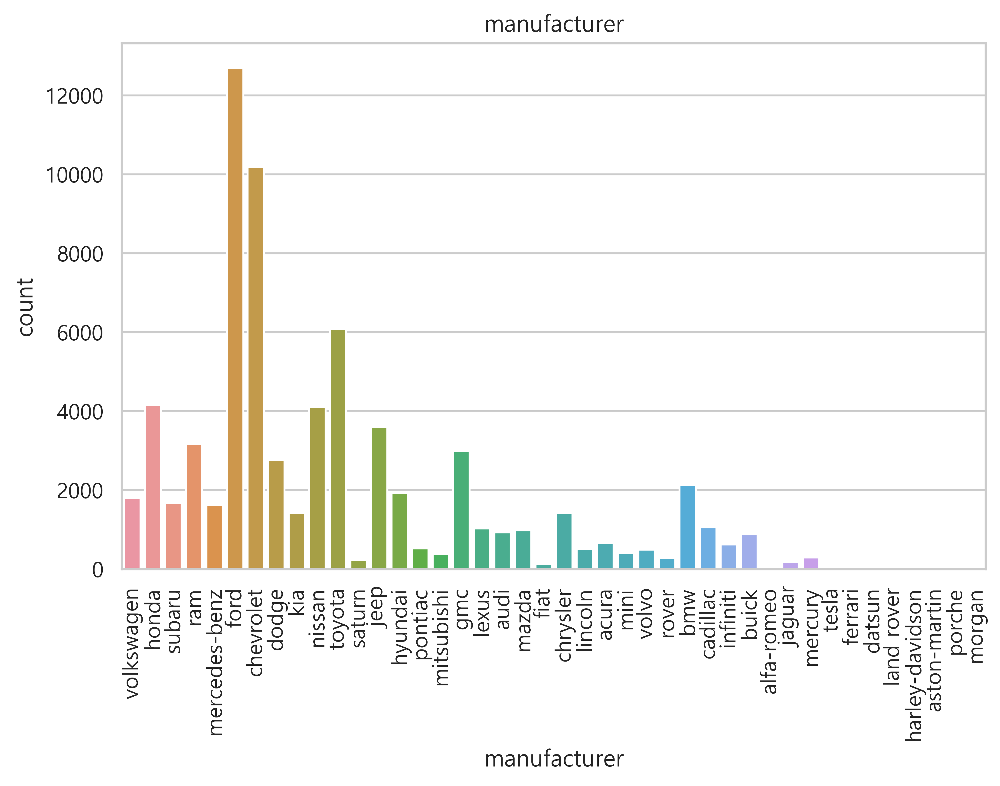

In [56]:
sns.countplot(df.manufacturer, ax=None)
plt.title("manufacturer")
plt.xticks(rotation=90)
plt.show()

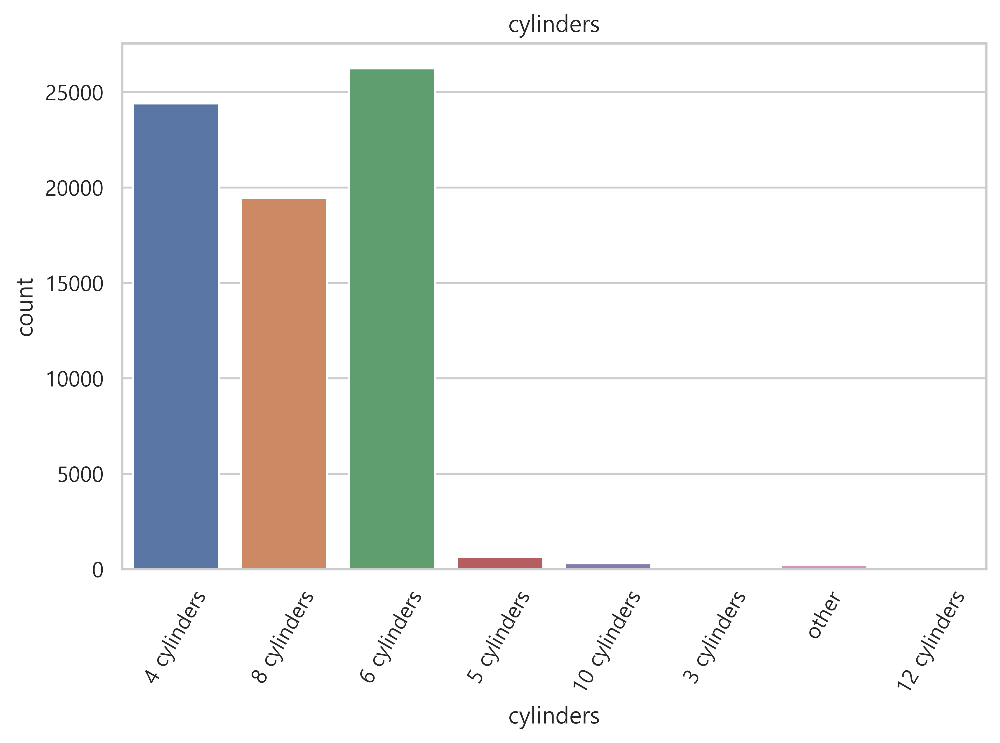

In [54]:
sns.countplot(df.cylinders, ax=None)
plt.title("cylinders")
plt.xticks(rotation=60)
plt.show()

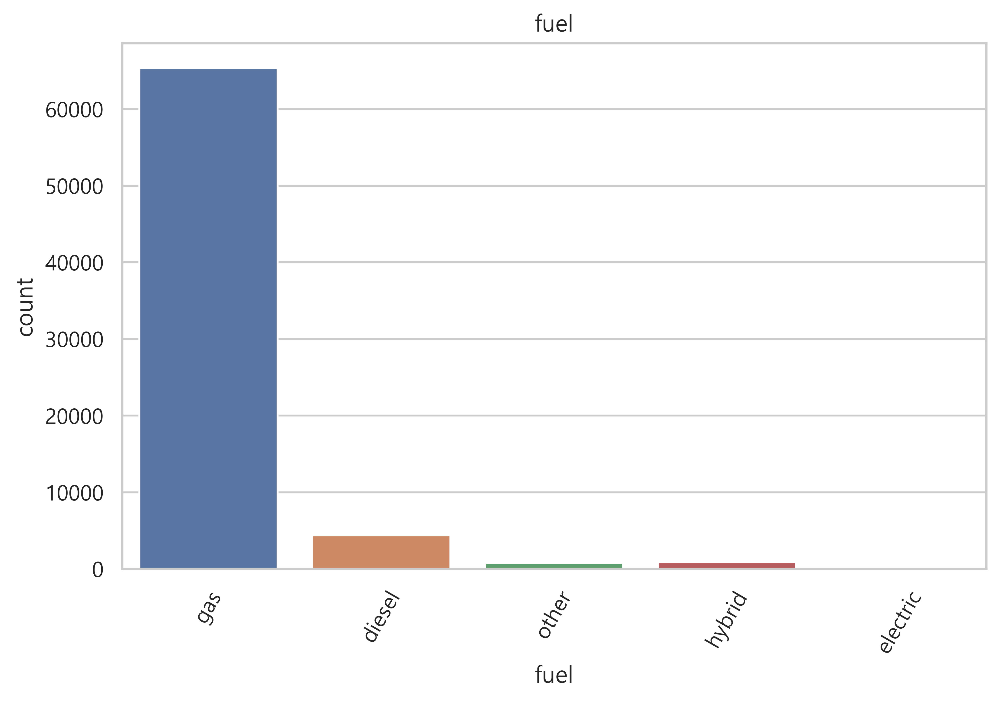

In [53]:
sns.countplot(df.fuel, ax=None)
plt.title("fuel")
plt.xticks(rotation=60)
plt.show()

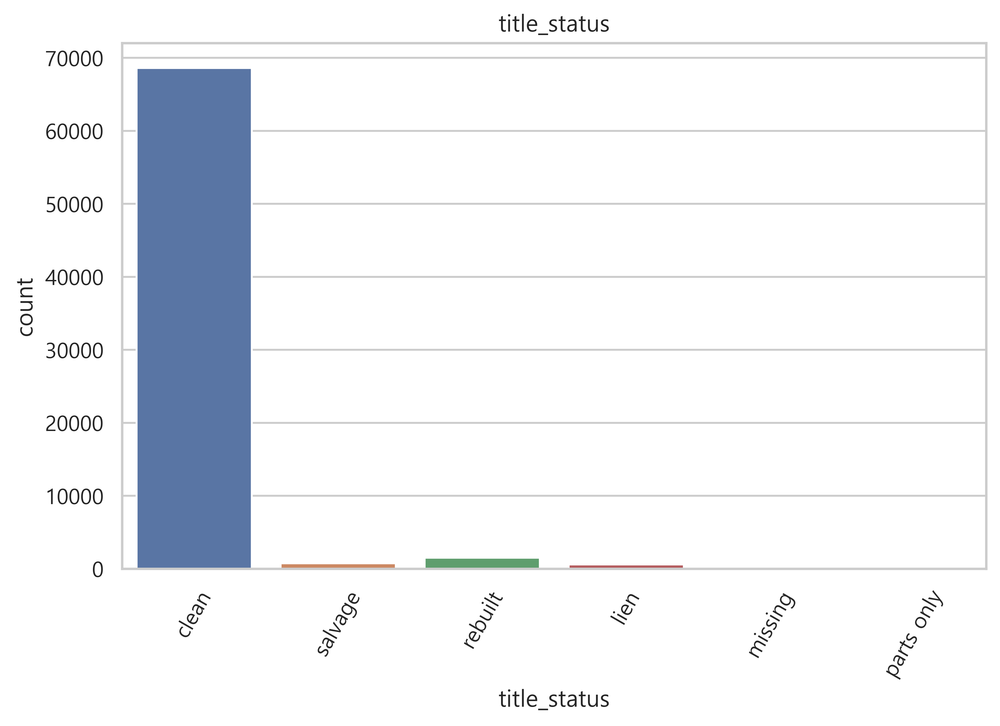

In [52]:
sns.countplot(df.title_status, ax=None)
plt.title("title_status")
plt.xticks(rotation=60)
plt.show()

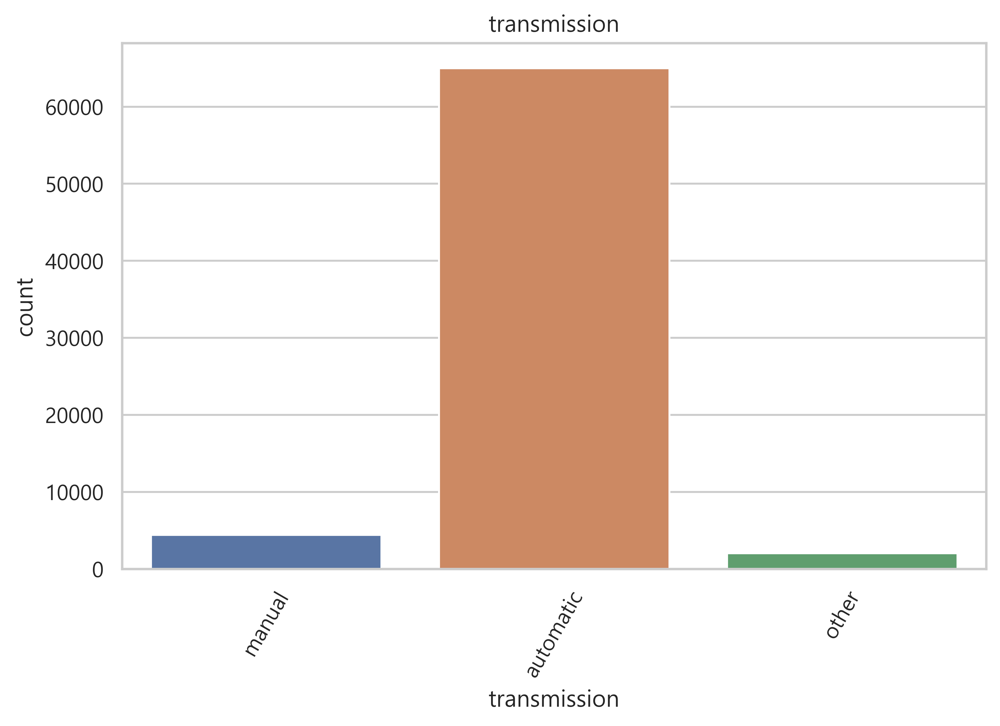

In [51]:
sns.countplot(df.transmission, ax=None)
plt.title("transmission")
plt.xticks(rotation=60)
plt.show()

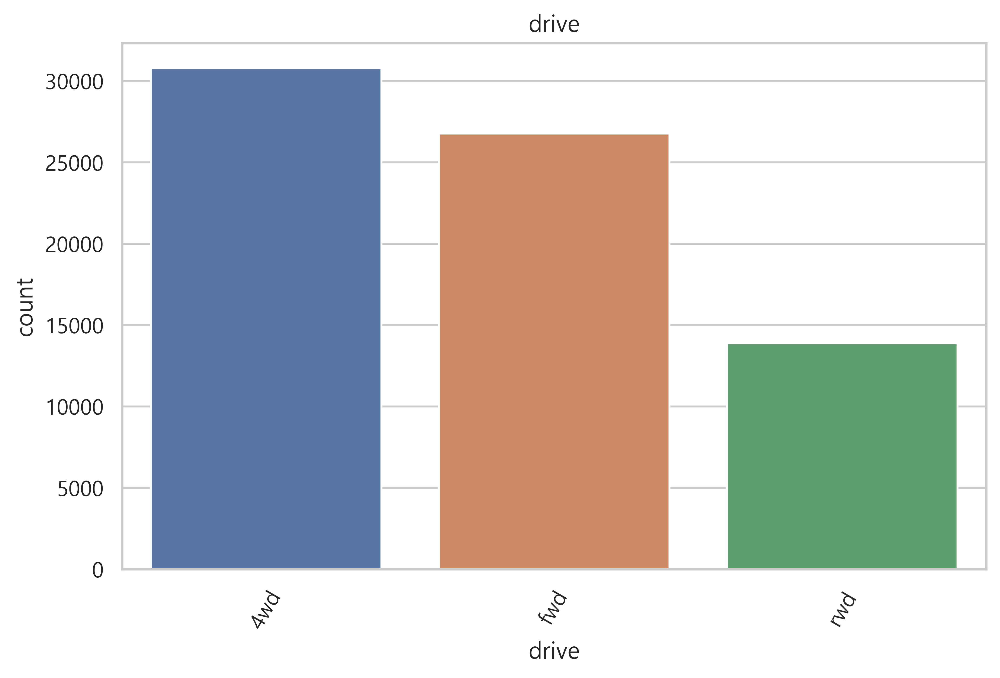

In [50]:
sns.countplot(df.drive, ax=None)
plt.title("drive")
plt.xticks(rotation=60)
plt.show()

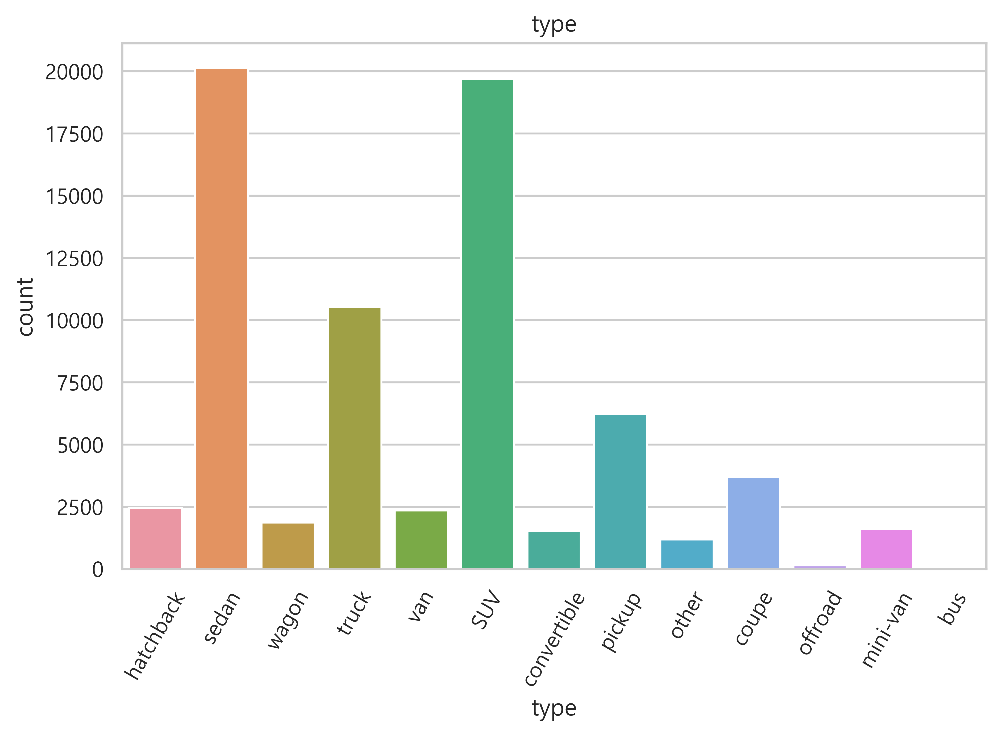

In [49]:
sns.countplot(df.type, ax=None)
plt.title("type")
plt.xticks(rotation=60)
plt.show()

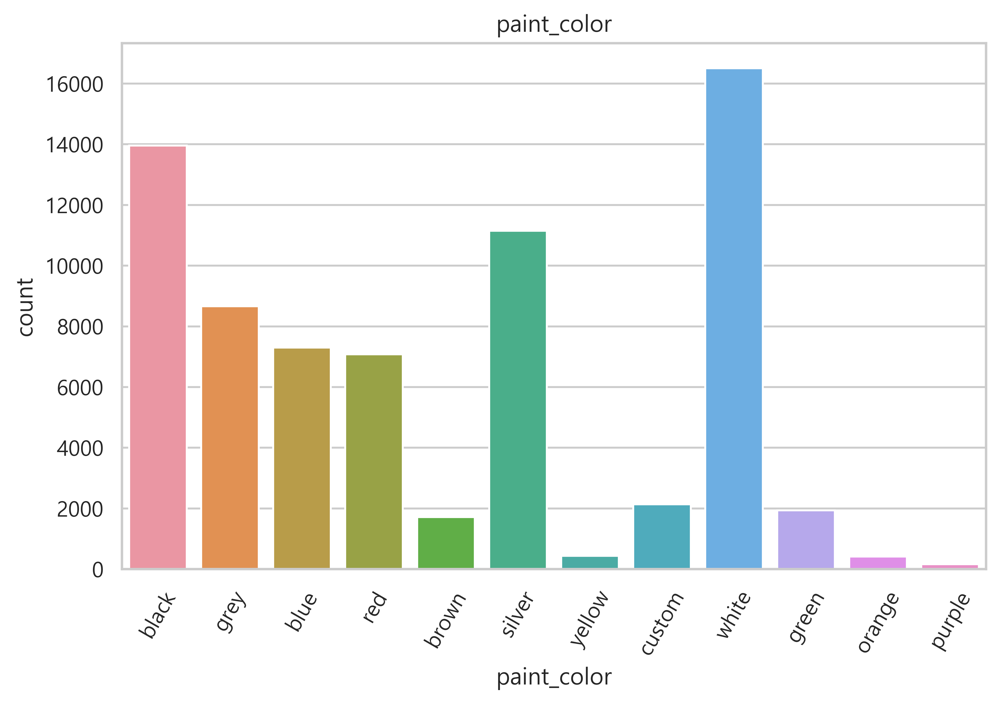

In [48]:
sns.countplot(df.paint_color, ax=None)
plt.title("paint_color")
plt.xticks(rotation=60)
plt.show()

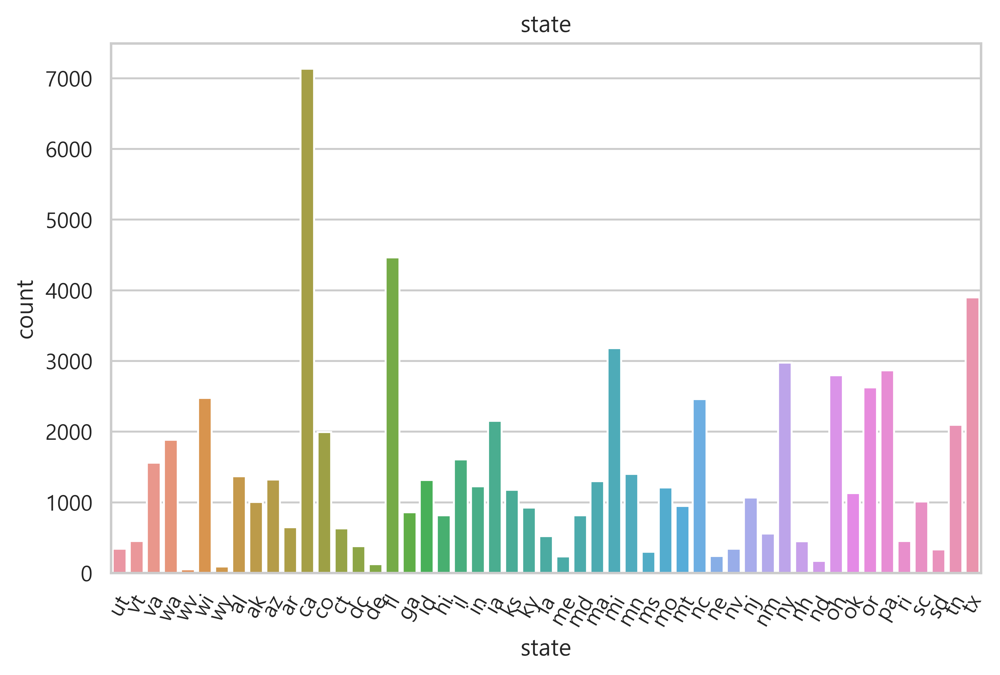

In [47]:
sns.countplot(df.state, ax=None)
plt.title("state")
plt.xticks(rotation=60)
plt.show()

# 2. 종속변수와 독립변수의 관계확인

### 2-1. 종속변수와 독립변수 분리하기
- dfx : 독립변수
- dfy : 종속변수

In [59]:
df.columns

Index(['id', 'price', 'year', 'manufacturer', 'cylinders', 'fuel', 'odometer',
       'title_status', 'transmission', 'vin', 'drive', 'type', 'paint_color',
       'state'],
      dtype='object')

In [126]:
dfX = pd.DataFrame(df, columns=["id", "year", "manufacturer", "cylinders", "fuel", "odometer", "title_status", "transmission", "vin", "drive", "type", "paint_color", "state"])
dfy = pd.DataFrame(df, columns=["price"])

In [127]:
dfX.head(2)

,id,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state
0,7034441763,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut
1,7034278551,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut


In [128]:
dfy.head(2)

,price
0,17899
1,4600


### 2-2. 독립변수, 종속변수 합치기
- car_df

In [129]:
car_df = pd.concat([dfX, dfy], axis=1)
car_df.head()

,id,year,manufacturer,cylinders,fuel,odometer,title_status,transmission,vin,drive,type,paint_color,state,price
0,7034441763,2012.0,volkswagen,4 cylinders,gas,63500.0,clean,manual,WVWPF7AJ6CW316713,4wd,hatchback,black,ut,17899
1,7034278551,2008.0,honda,4 cylinders,gas,110982.0,clean,automatic,2HGFA16528H503005,fwd,sedan,grey,ut,4600
2,7033943607,1999.0,subaru,4 cylinders,gas,215349.0,clean,automatic,4S3BG6859X6660102,4wd,wagon,blue,ut,3995
3,7033478714,2016.0,ram,8 cylinders,gas,19086.0,clean,automatic,1C6RR7GT6GS369389,4wd,truck,red,ut,28895
4,7033472903,2017.0,mercedes-benz,6 cylinders,diesel,35000.0,clean,other,WD4FE7CD1HP550108,4wd,van,blue,ut,105500


### 2-3. 종속변수와 독립변수의 관계 확인
- 스캐터 플롯
- price 와 id, year, odometer
- 범주형 독립변수는 제외

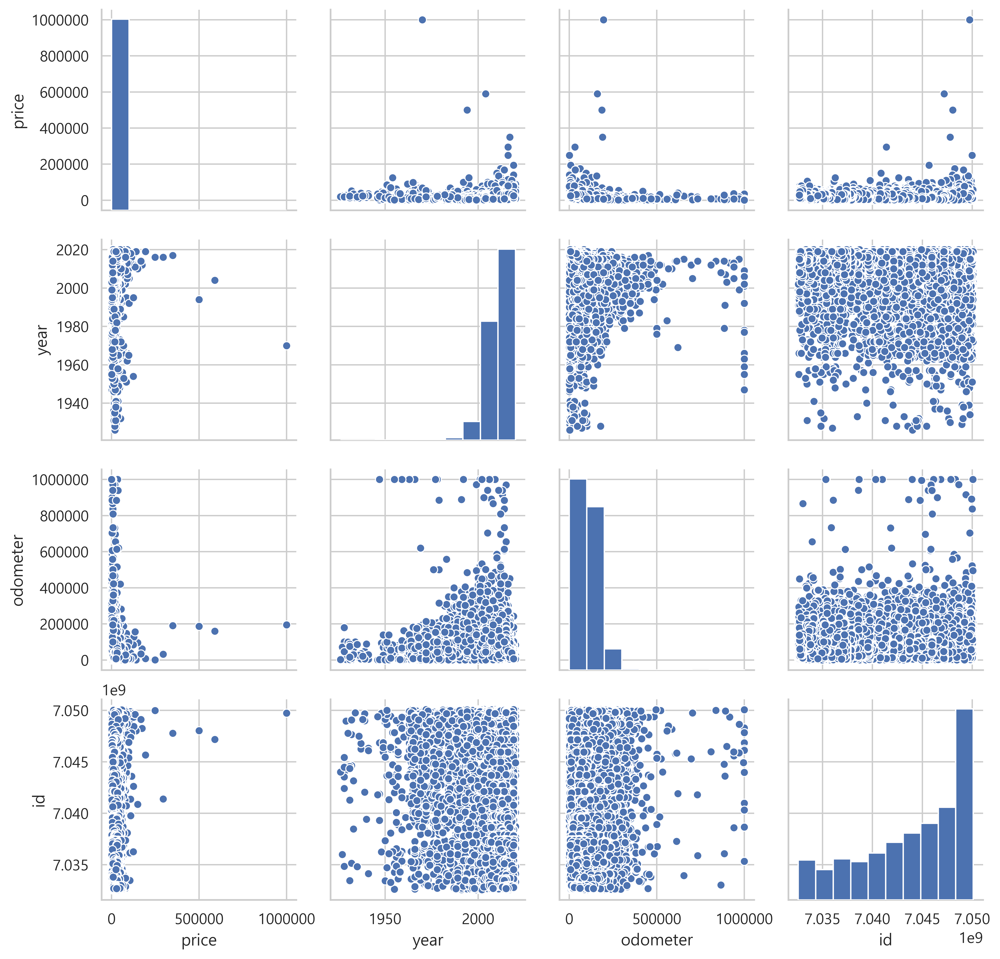

In [73]:
sns.pairplot(car_df[["price", "year", "odometer", "id"]])
plt.show()

### 2-4. 실수형 데이터 boxplot 확인.

In [90]:
import plotly.graph_objects as go

In [101]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["price"], name='price'))
fig.show()

In [100]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["odometer"], name='odometer'))
fig.show()

In [99]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["year"], name='year'))
fig.show()

In [98]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["id"], name='id'))
fig.show()

In [102]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["price"], name='price'))
fig.add_trace(go.Box(y=car_df["year"], name='year'))
fig.add_trace(go.Box(y=car_df["odometer"], name='odometer'))
fig.show()

### 2-5. 범주형 독립변수 박스플롯 확인

In [103]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["cylinders"], name='cylinders'))
fig.show()

In [104]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["manufacturer"], name='manufacturer'))
fig.show()

In [105]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["fuel"], name='fuel'))
fig.show()

In [106]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["title_status"], name='title_status'))
fig.show()

In [107]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["transmission"], name='transmission'))
fig.show()

In [108]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["vin"], name='vin'))
fig.show()

In [109]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["drive"], name='drive'))
fig.show()

In [110]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["type"], name='type'))
fig.show()

In [111]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["paint_color"], name='paint_color'))
fig.show()

In [112]:
fig = go.Figure()
fig.add_trace(go.Box(y=car_df["state"], name='state'))
fig.show()